## Run Millipede on sg218

### Install latest version of crispr-millipede

In [ ]:
reinstall = True

if reinstall:    
    version = "0.1.84"
    !pip install --upgrade --no-cache-dir crispr-millipede==$version

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

from crispr_millipede import encoding as cme
from crispr_millipede import modelling as cmm


In [2]:
import pandas as pd
import numpy as np

from Bio import SeqIO
from Bio.Seq import Seq

### Perform encoding

In [7]:
amplicon_sequence = "ACATGCTCTAGTGAAAGCCAGTCTGGGCAGCTGGGTAGCTAATGAGGGGATTAGAGAGATTTTGTTGAATGAAAGGCAGATTGAGTCCTGCTACTCGCCCCCTTCATTCCCCTTCATTCATGCCTCATTCTTCCGCCTCCCAGCCGCCTCAACTGGCCAAAGGGAAGTGGAGGCCCTGCCACCTGTAGGGAGGGTCCCCTGGGGCTTGCCCACAGCAAACAGGAAGTCACAGCCTGGTGAGATGGGCCTGGGAATCAGCCACTGAGAAAGTGGGTCTCTTGGGTCCCTGAATTCTTTTTCTGAGTCCCTGCAGCAGTGAAAAAGACACAGAGGCACATAGAGAGTG"

In [8]:
ABE_SNPs = [("A", "G"), ("T", "C")]

In [9]:
sg219_sequence = "ACAGGAAGTCACAGCCTGGT"
sg219_position = [amplicon_sequence.index(sg219_sequence) + 5]

In [24]:
sg219_encoding_parameters_fulldenoised_removed = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types = ABE_SNPs,
                            guide_edit_positions=sg219_position,
                            guide_window_halfsize=5,
                            trim_left=20,
                            trim_right=20,
                            remove_denoised=True)

sg219_encoding_parameters_fulldenoised_nonremoved = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types = ABE_SNPs,
                            guide_edit_positions=sg219_position,
                            guide_window_halfsize=5,
                            trim_left=20,
                            trim_right=20,                                           
                            remove_denoised=False)

sg219_encoding_parameters_variantdenoised_removed = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types = ABE_SNPs,
                            trim_left=20,
                            trim_right=20, 
                            remove_denoised=True)

sg219_encoding_parameters_variantdenoised_nonremoved = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            variant_types = ABE_SNPs,
                            trim_left=20,
                            trim_right=20,
                            remove_denoised=False)

sg219_encoding_parameters_positiondenoised_removed = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            guide_edit_positions=sg219_position,
                            guide_window_halfsize=5,
                            trim_left=20,
                            trim_right=20,
                            remove_denoised=True)

sg219_encoding_parameters_positiondenoised_nonremoved = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            guide_edit_positions=sg219_position,
                            guide_window_halfsize=5,
                            trim_left=20,
                            trim_right=20,
                            remove_denoised=False)

sg219_encoding_parameters_nondenoised = cme.EncodingParameters(complete_amplicon_sequence=amplicon_sequence,
                            population_baseline_suffix="_CD19minus",
                            population_target_suffix="_CD19plus",
                            population_presort_suffix="_presort",
                            wt_suffix="_wt",
                            trim_left=20,
                            trim_right=20,
                            remove_denoised=False)

In [25]:
# SG219 FLASH pre-merged FASTQs
# root_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231005_v1_CRISPResso2Batch_Results_q30/ABE8e_sg219/premerged/CRISPRessoBatch_on_ABE8e_sg219_premerged_middle/"

# SG219 CRISPResso2 merged FASTQS (20240905: Found less sequencing errors, which may remove the false positive sequencing error hit)
root_dir = "/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231005_v1_CRISPResso2Batch_Results_q30/ABE8e_sg219/unmerged_PE/CRISPRessoBatch_on_ABE8e_sg219_unmerged_PE_middle/"

sg219_encoding_dataframes_fulldenoised_removed = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_fulldenoised_removed,
                                                 reference_sequence=sg219_encoding_parameters_fulldenoised_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_fulldenoised_nonremoved = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_fulldenoised_nonremoved,
                                                 reference_sequence=sg219_encoding_parameters_fulldenoised_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_variantdenoised_removed = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_variantdenoised_removed,
                                                 reference_sequence=sg219_encoding_parameters_variantdenoised_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_variantdenoised_nonremoved = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_variantdenoised_nonremoved,
                                                 reference_sequence=sg219_encoding_parameters_variantdenoised_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_positiondenoised_removed = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_positiondenoised_removed,
                                                 reference_sequence=sg219_encoding_parameters_positiondenoised_removed.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_positiondenoised_nonremoved = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_positiondenoised_nonremoved,
                                                 reference_sequence=sg219_encoding_parameters_positiondenoised_nonremoved.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

sg219_encoding_dataframes_nondenoised = cme.EncodingDataFrames(encoding_parameters=sg219_encoding_parameters_nondenoised,
                                                 reference_sequence=sg219_encoding_parameters_nondenoised.complete_amplicon_sequence,
                                                 population_baseline_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_1/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_2/Alleles_frequency_table.zip", 
                                                                                root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_low_3/Alleles_frequency_table.zip"],
                                                 population_target_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_1/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_2/Alleles_frequency_table.zip", 
                                                                              root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_high_3/Alleles_frequency_table.zip"],
                                                 population_presort_filepaths=[root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_1/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_2/Alleles_frequency_table.zip", 
                                                                               root_dir + "CRISPResso_on_sample_ABE8e_PAX5sg_presort_3/Alleles_frequency_table.zip"],
                                                 wt_filepaths=["/data/pinello/PROJECTS/2023_08_CD19_manuscript/Core_Processing_Analysis/Analysis/ABE8e_Pooled_Endogenous_Redo_AND_ABE8e_sg219_Endogenous_AND_EvoCDA_Hits_Endogenous_CRISPREsso2_Analysis/20231002_v3_CRISPResso2Batch_Results/ABE8e_pooled/premerged_middle/CRISPRessoBatch_on_ABE8e_pooled_premerged_middle/CRISPResso_on_sample_mock_presort_1/Alleles_frequency_table.zip"])

In [26]:
# Iterate through runs:

millipede_runs_list = [("sg219_encoding_dataframes_variantdenoised_removed_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_variantdenoised_removed),
                       ("sg219_encoding_dataframes_fulldenoised_removed_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_fulldenoised_removed),
                       ("sg219_encoding_dataframes_positiondenoised_removed_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_positiondenoised_removed),
("sg219_encoding_dataframes_fulldenoised_nonremoved_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_fulldenoised_nonremoved),
("sg219_encoding_dataframes_variantdenoised_nonremoved_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_variantdenoised_nonremoved),
("sg219_encoding_dataframes_positiondenoised_nonremoved_CRISPResso2Merged_trimmed",sg219_encoding_dataframes_positiondenoised_nonremoved),
("sg219_encoding_dataframes_nondenoised_CRISPResso2Merged_trimmed", sg219_encoding_dataframes_nondenoised)]

In [27]:
import pickle

version = "20240905_v0_1_89"
for name, millipede_run in millipede_runs_list:
    print(f"Running {name}")
    
    # RUN ENCODING
    print("Reading tables")
    millipede_run.read_crispresso_allele_tables()
    print("Encoding tables")
    millipede_run.encode_crispresso_allele_table(progress_bar=True, cores=50)
    print("Postprocessing tables")
    millipede_run.postprocess_encoding()
    
    
    # SAVE PICKLE
    with open(f"{version}_{name}.pkl", 'wb') as fn: 
        pickle.dump(millipede_run, fn) 

    # SAVE ENCODINGS
    cme.save_encodings(millipede_run.encodings_collapsed_merged, sort_column="#Reads_presort", filename=f"./{version}_{name}_ABE8e_encodings_rep{{}}.tsv")
    cme.save_encodings(millipede_run.population_wt_encoding_processed, sort_column="#Reads_wt", filename=f"./{version}_{name}_wt_encodings_rep{{}}.tsv")
    cme.save_encodings_df(millipede_run.population_baseline_encoding_processed, filename=f"./{version}_{name}_CD19minus_ABE8e_encodings_rep{{}}.pkl")
    cme.save_encodings_df(millipede_run.population_target_encoding_processed, filename=f"./{version}_{name}_CD19plus_ABE8e_encodings_rep{{}}.pkl")
    cme.save_encodings_df(millipede_run.population_presort_encoding_processed, filename=f"./{version}_{name}_presort_ABE8e_encodings_rep{{}}.pkl")
    cme.save_encodings_df(millipede_run.population_wt_encoding_processed, filename=f"./{version}_{name}_wt_encodings_rep{{}}.pkl")

Running sg219_encoding_dataframes_variantdenoised_removed_CRISPResso2Merged_trimmed
Reading tables
Encoding tables
INFO: Pandarallel will run on 50 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [] and variant types [('A', 'G'), ('T', 'C')]
Filtering by variant types
1393 variant types
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>G', '35T>N', '35T>-', '36A>C', '36A>T', '36A>N', '36A>-', '37G>A', '37G>C', '37G>T',

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

Running sg219_encoding_dataframes_fulldenoised_removed_CRISPResso2Merged_trimmed
Reading tables
Encoding tables
INFO: Pandarallel will run on 50 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [223] and variant types [('A', 'G'), ('T', 'C')]
Filtering by editable positions
1475 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>G', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>C', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>C', '35T>G', '35T>N', '35T>-', 

Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [223] and variant types []
Filtering by editable positions
1475 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>G', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>C', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>C', '35T>G', '35T>N', '35T>-', '36A>C', '36A>T', '36A

Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [223] and variant types [('A', 'G'), ('T', 'C')]
Filtering by editable positions
1475 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>G', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>C', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>C', '35T>G', '35T>N', '35T>-', 

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

Running sg219_encoding_dataframes_variantdenoised_nonremoved_CRISPResso2Merged_trimmed
Reading tables
Encoding tables
INFO: Pandarallel will run on 50 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [] and variant types [('A', 'G'), ('T', 'C')]
Filtering by variant types
1393 variant types
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>G', '35T>N', '35T>-', '36A>C', '36A>T', '36A>N', '36A>-', '37G>A', '37G>C', '37G>T',

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

Running sg219_encoding_dataframes_positiondenoised_nonremoved_CRISPResso2Merged_trimmed
Reading tables
Encoding tables
INFO: Pandarallel will run on 50 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Denoising with positions [223] and variant types []
Filtering by editable positions
1475 non-editable positions
['20G>A', '20G>C', '20G>T', '20G>N', '20G>-', '21T>A', '21T>C', '21T>G', '21T>N', '21T>-', '22C>A', '22C>T', '22C>G', '22C>N', '22C>-', '23T>A', '23T>C', '23T>G', '23T>N', '23T>-', '24G>A', '24G>C', '24G>T', '24G>N', '24G>-', '25G>A', '25G>C', '25G>T', '25G>N', '25G>-', '26G>A', '26G>C', '26G>T', '26G>N', '26G>-', '27C>A', '27C>T', '27C>G', '27C>N', '27C>-', '28A>C', '28A>T', '28A>G', '28A>N', '28A>-', '29G>A', '29G>C', '29G>T', '29G>N', '29G>-', '30C>A', '30C>T', '30C>G', '30C>N', '30C>-', '31T>A', '31T>C', '31T>G', '31T>N', '31T>-', '32G>A', '32G>C', '32G>T', '32G>N', '32G>-', '33G>A', '33G>C', '33G>T', '33G>N', '33G>-', '34G>A', '34G>C', '34G>T', '34G>N', '34G>-', '35T>A', '35T>C', '35T>G', '35T>N', '35T>-', '36A>C', '36A>T', '36A

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

Running sg219_encoding_dataframes_nondenoised_CRISPResso2Merged_trimmed
Reading tables
Encoding tables
INFO: Pandarallel will run on 50 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
Encoding population_baseline_df


Encoding population_target_df


Encoding population_presort_df


Encoding population_wt_df


Postprocessing tables
Trimming encodings with trim_left=20 and trim_right=20
Processing encoding columns
Adding read column
Performing denoising
Not denoising sample
Not denoising sample
Not denoising sample
Not denoising sample
Collapsing encoding


/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.groupby(feature_colnames, as_index=True).sum().reset_index())
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/crispr_millipede/encoding/encoding.py:227: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  encoded_dfs_collapsed.append(encoded_df_rep.

#### Exploratory analysis of editing frequencies to investigate sequencing error hit

In [10]:
paired_merged_raw_encodings = cmm.RawEncodingDataframesExperimentalGroup().read_in_files_constructor(
    enriched_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_variantdenoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl"],
    baseline_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_variantdenoised_removed_CD19plus_ABE8e_encodings_rep{}.pkl"], 
    presort_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_variantdenoised_removed_presort_ABE8e_encodings_rep{}.pkl"],
    experiment_labels=["ABE8e"],
    ctrl_pop_fn_encodings="./20240828_v0_1_84_sg219_encoding_dataframes_variantdenoised_removed_wt_encodings_rep0.pkl",
    ctrl_pop_labels="WT",
    reps=[0,1,2])
paired_merged_raw_encodings_editing_freqs = cmm.EncodingEditingFrequenciesExperimentalGroup(paired_merged_raw_encodings)
paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_experiment_list

['./20240828_v0_1_84_sg219_encoding_dataframes_variantdenoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl']
Reading enriched population...
Reading baseline population...
Reading presort population if provided...
Reading control population if provided...
Passed post-validation
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated


[[FullChange
  0A>G      0.002710
  2A>G      0.001277
  3T>C      0.000663
  6T>C      0.000368
  8T>C      0.000295
              ...   
  337T>C    0.000450
  338A>G    0.000909
  340A>G    0.001883
  342A>G    0.001359
  344T>C    0.001981
  Length: 158, dtype: float64,
  FullChange
  0A>G      0.002198
  2A>G      0.001882
  3T>C      0.000794
  6T>C      0.000529
  8T>C      0.000419
              ...   
  337T>C    0.000309
  338A>G    0.000875
  340A>G    0.001853
  342A>G    0.002044
  344T>C    0.001096
  Length: 158, dtype: float64,
  FullChange
  0A>G      0.002214
  2A>G      0.001391
  3T>C      0.000546
  6T>C      0.000369
  8T>C      0.000369
              ...   
  337T>C    0.000446
  338A>G    0.000638
  340A>G    0.001945
  342A>G    0.002221
  344T>C    0.001253
  Length: 158, dtype: float64]]

In [14]:
paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_avg[0].sort_values(ascending=False)

FullChange
223A>G    0.744715
220A>G    0.647391
224A>G    0.631696
228A>G    0.583250
230A>G    0.136916
            ...   
167T>C    0.000137
126A>G    0.000134
119A>G    0.000133
185T>C    0.000121
127T>C    0.000120
Length: 158, dtype: float64

In [16]:
paired_merged_raw_encodings_full = cmm.RawEncodingDataframesExperimentalGroup().read_in_files_constructor(
    enriched_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_fulldenoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl"],
    baseline_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_fulldenoised_removed_CD19plus_ABE8e_encodings_rep{}.pkl"], 
    presort_pop_fn_encodings_experiment_list=["./20240828_v0_1_84_sg219_encoding_dataframes_fulldenoised_removed_presort_ABE8e_encodings_rep{}.pkl"],
    experiment_labels=["ABE8e"],
    ctrl_pop_fn_encodings="./20240828_v0_1_84_sg219_encoding_dataframes_fulldenoised_removed_wt_encodings_rep0.pkl",
    ctrl_pop_labels="WT",
    reps=[0,1,2])
paired_merged_raw_encodings_editing_freqs_full = cmm.EncodingEditingFrequenciesExperimentalGroup(paired_merged_raw_encodings_full)


['./20240828_v0_1_84_sg219_encoding_dataframes_fulldenoised_removed_CD19minus_ABE8e_encodings_rep{}.pkl']
Reading enriched population...
Reading baseline population...
Reading presort population if provided...
Reading control population if provided...
Passed post-validation
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated
ctrl_pop_encoding_editing_freq_avg_level was set to max depth of ctrl_pop_encodings_df_list, so no average was calculated


In [17]:
paired_merged_raw_encodings_editing_freqs_full.presort_pop_encoding_editing_per_variant_freq_avg[0].sort_values(ascending=False)

FullChange
223A>G    0.744715
220A>G    0.647391
224A>G    0.631696
228A>G    0.583250
218A>G    0.005791
226T>C    0.000448
dtype: float64

In [27]:
paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_avg[0].sort_values(ascending=False).head(10)

FullChange
223A>G    0.744715
220A>G    0.647391
224A>G    0.631696
228A>G    0.583250
230A>G    0.136916
298T>C    0.008107
295T>C    0.007745
294T>C    0.006574
300T>C    0.006140
287T>C    0.005871
dtype: float64

In [30]:
for rep in paired_merged_raw_encodings_editing_freqs.presort_pop_encoding_editing_per_variant_freq_experiment_list[0]:
    display(rep.sort_values(ascending=False).head(30))

FullChange
223A>G    0.737521
220A>G    0.636041
224A>G    0.622852
228A>G    0.570839
230A>G    0.129005
295T>C    0.008359
298T>C    0.008318
294T>C    0.007483
287T>C    0.006984
283T>C    0.006157
300T>C    0.005936
292T>C    0.005444
218A>G    0.005428
321A>G    0.005223
291T>C    0.004585
276T>C    0.004347
297T>C    0.003840
304T>C    0.003660
254T>C    0.003578
278T>C    0.003504
270T>C    0.003471
311A>G    0.003422
50T>C     0.003152
42T>C     0.003029
49A>G     0.002980
279T>C    0.002898
35T>C     0.002882
217A>G    0.002816
260A>G    0.002767
64T>C     0.002726
dtype: float64

FullChange
223A>G    0.739365
220A>G    0.644864
224A>G    0.628741
228A>G    0.575752
230A>G    0.137468
298T>C    0.009168
294T>C    0.006367
321A>G    0.006066
291T>C    0.005926
295T>C    0.005853
297T>C    0.005728
276T>C    0.005669
218A>G    0.005573
287T>C    0.005419
300T>C    0.005220
42T>C     0.005205
292T>C    0.004823
283T>C    0.004433
60T>C     0.004353
50T>C     0.004257
270T>C    0.004036
59T>C     0.003978
77A>G     0.003772
304T>C    0.003632
35T>C     0.003544
254T>C    0.003537
49A>G     0.003419
278T>C    0.003073
279T>C    0.002338
217A>G    0.002331
dtype: float64

FullChange
223A>G    0.757258
220A>G    0.661268
224A>G    0.643497
228A>G    0.603158
230A>G    0.144277
295T>C    0.009024
300T>C    0.007264
298T>C    0.006833
291T>C    0.006618
218A>G    0.006372
321A>G    0.006265
42T>C     0.005965
294T>C    0.005873
287T>C    0.005211
50T>C     0.004881
60T>C     0.004727
59T>C     0.004535
292T>C    0.004527
254T>C    0.004074
35T>C     0.003997
77A>G     0.003997
283T>C    0.003582
304T>C    0.003513
49A>G     0.003436
276T>C    0.003313
297T>C    0.002990
270T>C    0.002890
36A>G     0.002460
41A>G     0.002321
40A>G     0.002283
dtype: float64

In [25]:
paired_merged_raw_encodings_editing_freqs_full.presort_pop_encoding_editing_per_variant_freq_experiment_list

[[FullChange
  218A>G    0.005428
  220A>G    0.636041
  223A>G    0.737521
  224A>G    0.622852
  226T>C    0.000442
  228A>G    0.570839
  dtype: float64,
  FullChange
  218A>G    0.005573
  220A>G    0.644864
  223A>G    0.739365
  224A>G    0.628741
  226T>C    0.000294
  228A>G    0.575752
  dtype: float64,
  FullChange
  218A>G    0.006372
  220A>G    0.661268
  223A>G    0.757258
  224A>G    0.643497
  226T>C    0.000607
  228A>G    0.603158
  dtype: float64]]

In [146]:
name="sg219_encoding_dataframes_nondenoised"

design_matrix_spec = cmm.MillipedeDesignMatrixProcessingSpecification(
    wt_normalization=False,
    total_normalization=True,
    sigma_scale_normalized=True,
    decay_sigma_scale=True,
    K_enriched=5,
    K_baseline=5,
    a_parameter=0.0005,
    set_offset_as_presort = True,
    offset_normalized = False,
    offset_psuedocount = 1 # OTHERWISE will get infinity error when taking log(count +1) for offset, since 0 counts could be acceptable depending on thresholding
)

millipede_model_specification_set = {
    "joint_replicate_per_experiment_models" : cmm.MillipedeModelSpecification(
        model_types=[cmm.MillipedeModelType.NORMAL_SIGMA_SCALED],
        replicate_merge_strategy=cmm.MillipedeReplicateMergeStrategy.COVARIATE,
        experiment_merge_strategy=cmm.MillipedeExperimentMergeStrategy.SEPARATE,
        S = 5,
        tau = 0.01,
        tau_intercept = 0.0001,
        cutoff_specification=cmm.MillipedeCutoffSpecification(
            per_replicate_each_condition_num_cutoff = 0, 
            per_replicate_all_condition_num_cutoff = 1, 
            all_replicate_num_cutoff = 0, 
            all_experiment_num_cutoff = 0,
            baseline_pop_all_condition_each_replicate_num_cutoff = 0,
            baseline_pop_all_condition_acceptable_rep_count = 2,
            enriched_pop_all_condition_each_replicate_num_cutoff = 0,
            enriched_pop_all_condition_acceptable_rep_count = 2,
            presort_pop_all_condition_each_replicate_num_cutoff = 0,
            presort_pop_all_condition_acceptable_rep_count = 2,
            
        ),
        design_matrix_processing_specification=design_matrix_spec
    )
}

paired_end_experiments_inputdata_denoised = cmm.MillipedeInputDataExperimentalGroup(
    data_directory="./", 
    enriched_pop_fn_experiment_list = [f"./20240828_v0_1_84_{name}_ABE8e_encodings_rep{{}}.tsv"],
    enriched_pop_df_reads_colname = "#Reads_CD19minus",
    baseline_pop_fn_experiment_list = [f"./20240828_v0_1_84_{name}_ABE8e_encodings_rep{{}}.tsv"],
    baseline_pop_df_reads_colname = "#Reads_CD19plus", 
    presort_pop_fn_experiment_list = [f"./20240828_v0_1_84_{name}_ABE8e_encodings_rep{{}}.tsv"],
    presort_pop_df_reads_colname = '#Reads_presort',
    experiment_labels = ["ABE8e"],
    reps = [0,1,2],
    millipede_model_specification_set = millipede_model_specification_set
   )


Performing initial input validation checks...
Passed validation.
Retrieving data for
	Replicate Merge Strategy: MillipedeReplicateMergeStrategy.COVARIATE 
	Experiment Merge Strategy MillipedeExperimentMergeStrategy.SEPARATE
	Cutoff: 
                    per_replicate_each_condition_num_cutoff=0, 
                    per_replicate_presort_condition_num_cutoff=0, 
                    per_replicate_all_condition_num_cutoff=1, 
                    all_replicate_num_cutoff=0, 
                    all_experiment_num_cutoff=0, 
                    baseline_pop_per_condition_acceptable_rep_count=0, 
                    baseline_pop_per_condition_acceptable_rep_count=0, 
                    baseline_pop_per_condition_acceptable_rep_count=0,
                    enriched_pop_per_condition_each_replicate_num_cutoff=0,
                    enriched_pop_per_condition_acceptable_rep_count=0,
                    presort_pop_per_condition_each_replicate_num_cutoff=0,
                    presort_pop_per_

In [147]:
data = paired_end_experiments_inputdata_denoised.millipede_model_specification_set_with_data['joint_replicate_per_experiment_models'][1].data[0]
condition_suffixes = ("CD19minus", "CD19plus")

In [148]:
import functools
from pydeseq2.dds import DeseqDataSet
from pydeseq2.default_inference import DefaultInference
from pydeseq2.ds import DeseqStats
from pydeseq2.utils import load_example_data

def perform_allele_deseq2(full_data_input, condition_suffixes):
    intercept_col_list = [col for col in full_data_input.columns if "intercept" in col]

    # Get allele counts dataframe for each replicate
    population_allele_counts_rep_list = []
    for rep_i, intercept_col in enumerate(intercept_col_list):
        data_rep = full_data_input[full_data_input[intercept_col] == 1]
        nt_columns = [col for col in data_rep.columns if ">" in col]

        allele_ids = data_rep.loc[:, nt_columns].apply(lambda row: ",".join(row[row==1].index), axis=1)
        allele_ids = allele_ids.rename("edits")
        allele_ids[allele_ids == ""] = "wt"
        population_allele_counts = data_rep.loc[:, [f"#Reads_{condition_suffixes[0]}_raw", f"#Reads_{condition_suffixes[1]}_raw"]]
        population_allele_counts.columns = [read_column + f"_rep{rep_i}"for read_column in population_allele_counts.columns]
        population_allele_counts.index = allele_ids
        population_allele_counts_rep_list.append(population_allele_counts)

    # Merge the replicates
    population_allele_counts_merged = functools.reduce(lambda left, right: pd.merge(left, right, on="edits", how='outer').fillna(0), population_allele_counts_rep_list)
    population_allele_counts_merged = population_allele_counts_merged.T
    population_allele_counts_merged.index.names = ["sample"]
    
    sample_metadata_series_list = []
    for rep_i in range(len(intercept_col_list)):
        for condition_suffix in condition_suffixes:
            sample_metadata_series_list.append(pd.Series([condition_suffix, rep_i], index=["condition", "replicate"]))
    metadata_df = pd.DataFrame(sample_metadata_series_list)
    metadata_df.index = population_allele_counts_merged.index
    metadata_df
    
    inference = DefaultInference(n_cpus=8)
    dds = DeseqDataSet(
        counts=population_allele_counts_merged,
        metadata=metadata_df,
        design_factors="condition",
        refit_cooks=True,
        inference=inference,
        # n_cpus=8, # n_cpus can be specified here or in the inference object
    )
    
    dds.deseq2()
    
    stat_res = DeseqStats(dds, inference=inference)
    
    display(stat_res.summary(lfc_null=0.1, alt_hypothesis="greaterAbs"))
    
    stat_res.plot_MA(s=20)
    
    results_df = stat_res.results_df
    results_df = results_df[['log2FoldChange','pvalue', 'padj']].dropna()
    results_df["-10log(pvalue)"] = np.log10(list(results_df["pvalue"])) * -10
    results_df["-10log(padj)"] = np.log10(list(results_df["padj"])) * -10
    
    return (results_df.sort_values("-10log(pvalue)", ascending=False), population_allele_counts_merged, metadata_df)

Fitting size factors...
... done in 0.03 seconds.

Fitting dispersions...
... done in 11.17 seconds.

Fitting dispersion trend curve...
... done in 5.69 seconds.

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/anndata/_core/views.py:144: RuntimeWarning: invalid value encountered in log
  results = super().__array_ufunc__(
Fitting MAP dispersions...
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/pydeseq2/utils.py:667: RuntimeWarning: invalid value encountered in log
  log_alpha_hat = np.log(alpha_hat)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/pydeseq2/utils.py:708: RuntimeWarning: invalid value encountered in log
  x0=np.log(alpha_hat),
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/bb_millipede_gpu_py310/lib/python3.10/site-packages/numpy/linalg/linalg.py:2079: RuntimeWarning: invalid value encountered in slogde

Log2 fold change & Wald test p-value: condition CD19plus vs CD19minus
                                                       baseMean  \
edits                                                             
wt                                                  8772.852317   
345G>-                                                 2.305506   
345G>N                                              1548.809396   
345G>T                                                 7.604824   
345G>C                                                 8.150077   
...                                                         ...   
0A>C,1C>A,11T>G,16G>A,74G>C,220A>G,223A>G,224A>...     0.187077   
0A>C,1C>A,9A>C,220A>G,223A>G,224A>G,228A>G             0.187077   
0A>C,1C>A,9A>C,16G>C,223A>G,224A>G,341G>N,343G>...     0.187077   
0A>C,1C>A,5C>A,16G>T,18C>G,19A>C,20G>T,28A>C,12...     0.162240   
0A>C,1C>A,5C>A,11T>A,33G>T,44A>T,45G>T,48G>T,71...     0.162240   

                                                    log2Fo

None

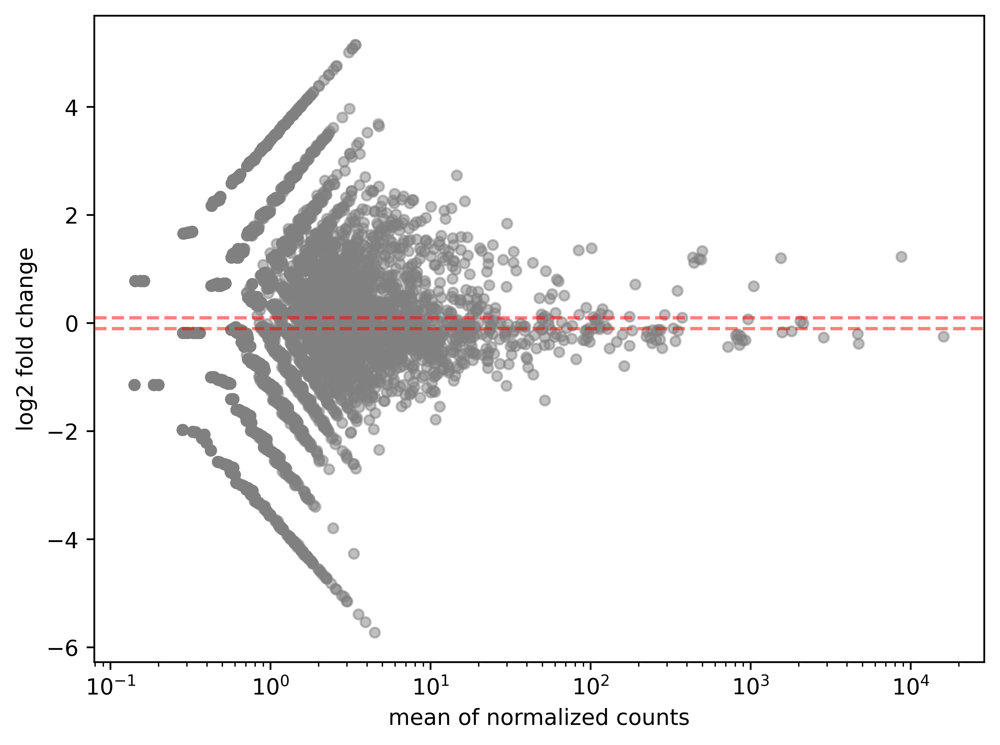

In [149]:
results_df = perform_allele_deseq2(data, condition_suffixes)

In [150]:
import matplotlib.pyplot as plt
plt.scatter(results_df["log2FoldChange"], results_df["-10log(pvalue)"], s=5, alpha=0.5)
plt.title("allele scores")
plt.xlabel("LFC")
plt.ylabel("-10log10(p-value)")

plt.show()

TypeError: tuple indices must be integers or slices, not str

In [151]:
results_df.sort_values("-10log(padj)", ascending=False)

AttributeError: 'tuple' object has no attribute 'sort_values'

In [152]:
results_df["log2FoldChangeWt"] = results_df.loc["wt", "log2FoldChange"] - results_df["log2FoldChange"]

AttributeError: 'tuple' object has no attribute 'loc'

In [ ]:
results_df.sort_values("log2FoldChangeWt", ascending=True).head(20)

In [153]:
results_df_rep0 = results_df[1].T.loc[:, ["#Reads_CD19minus_raw_rep0", "#Reads_CD19plus_raw_rep0"]] 
results_df_rep0["#Reads_CD19plus_raw_rep0"] = results_df_rep0.loc[:, "#Reads_CD19plus_raw_rep0"]  * (results_df_rep0.loc["wt", "#Reads_CD19minus_raw_rep0"] / results_df_rep0.loc["wt", "#Reads_CD19plus_raw_rep0"]) 

In [154]:
results_df_rep0.loc[p]

NameError: name 'p' is not defined

In [177]:
#results_df_normalized = results_df[1].T * results_df[1].T.loc["wt", :]
results_df_normalized = results_df[1].T/results_df[1].T.sum(axis=0)

In [156]:
results_df_rep0.loc["223A>G", :]

sample
#Reads_CD19minus_raw_rep0    330.000000
#Reads_CD19plus_raw_rep0     203.765588
Name: 223A>G, dtype: float64

In [157]:
results_df_rep0.loc["224A>G", :]

sample
#Reads_CD19minus_raw_rep0    73.000000
#Reads_CD19plus_raw_rep0     24.183169
Name: 224A>G, dtype: float64

In [158]:
results_df_rep0.loc["224A>G", :]

sample
#Reads_CD19minus_raw_rep0    73.000000
#Reads_CD19plus_raw_rep0     24.183169
Name: 224A>G, dtype: float64

In [159]:
results_df_normalized.loc["276T>C", :]

sample
#Reads_CD19minus_raw_rep0         0.0
#Reads_CD19plus_raw_rep0     102725.0
#Reads_CD19minus_raw_rep1         0.0
#Reads_CD19plus_raw_rep1      28516.0
#Reads_CD19minus_raw_rep2         0.0
#Reads_CD19plus_raw_rep2     124707.0
Name: 276T>C, dtype: float64

In [176]:
results_df_rep0

sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0,score
edits,,,
wt,6572.0,6572.000000,0.000000
345G>-,1.0,1.791346,-0.283500
345G>N,1132.0,1142.430801,-0.004586
345G>T,8.0,5.821874,0.157585
345G>C,3.0,8.061056,-0.457556
...,...,...,...
"0A>C,1C>A,11T>G,16G>A,74G>C,220A>G,223A>G,224A>G,228A>G",0.0,0.000000,NaN
"0A>C,1C>A,9A>C,220A>G,223A>G,224A>G,228A>G",0.0,0.000000,NaN
"0A>C,1C>A,9A>C,16G>C,223A>G,224A>G,341G>N,343G>N,345G>N",0.0,0.000000,NaN


In [197]:
results_df_normalized.loc[[allele for allele in results_df_normalized.index if "wt" in allele], :].sum(axis=0)

sample
#Reads_CD19minus_raw_rep0    0.048927
#Reads_CD19plus_raw_rep0     0.104680
#Reads_CD19minus_raw_rep1    0.046836
#Reads_CD19plus_raw_rep1     0.110487
#Reads_CD19minus_raw_rep2    0.043968
#Reads_CD19plus_raw_rep2     0.095230
score                       -0.362957
dtype: float64

In [172]:
results_df_rep0.loc["276T>C", :]

sample
#Reads_CD19minus_raw_rep0    0.000000
#Reads_CD19plus_raw_rep0     3.134855
score                       -1.000000
Name: 276T>C, dtype: float64

In [161]:
alleles_223 = [allele for allele in results_df_rep0.index if "223A>G" in allele]

In [162]:
results_df_rep0.loc[alleles_223, :].sort_values("#Reads_CD19minus_raw_rep0", ascending=False).head(25)

sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0
edits,,
"220A>G,223A>G,224A>G,228A>G",20827.0,7533.504872
"220A>G,223A>G,224A>G",6204.0,2195.294310
"220A>G,223A>G,224A>G,228A>G,230A>G",5946.0,2099.905145
"220A>G,223A>G,224A>G,228A>G,345G>N",3642.0,1305.443271
"220A>G,223A>G",2513.0,983.896695
"220A>G,223A>G,228A>G",2416.0,1131.682726
"223A>G,224A>G,228A>G",2302.0,901.942624
"223A>G,224A>G",2079.0,762.665486
"17C>N,18C>N,220A>G,223A>G,224A>G,228A>G,332G>N,339G>N,341G>N,343G>N,345G>N",1195.0,415.592232


In [163]:
results_df_rep0.loc[alleles_223, :]

sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0
edits,,
223A>G,330.0,203.765588
"223A>G,345G>-",1.0,0.447836
"223A>G,345G>N",72.0,39.409608
"223A>G,345G>T",0.0,0.895673
"223A>G,344T>G,345G>C",1.0,0.447836
...,...,...
"0A>C,1C>A,17C>N,18C>N,220A>G,223A>G,224A>G,228A>G,250G>T,332G>N,339G>N,341G>N,343G>N,345G>N",0.0,0.000000
"0A>C,1C>A,11T>G,16G>A,74G>C,220A>G,223A>G,224A>G,228A>G",0.0,0.000000
"0A>C,1C>A,9A>C,220A>G,223A>G,224A>G,228A>G",0.0,0.000000


In [164]:
nt_columns = [col for col in data.columns if ">" in col]

In [165]:
results_df_rep0["score"] = (results_df_rep0["#Reads_CD19minus_raw_rep0"] - results_df_rep0["#Reads_CD19plus_raw_rep0"]) / (results_df_rep0["#Reads_CD19minus_raw_rep0"] + results_df_rep0["#Reads_CD19plus_raw_rep0"])

In [170]:
nt_columns = [allele for allele in results_df_rep0.index if allele in nt_columns]

In [180]:
results_df_rep0_subs = results_df_rep0.loc[nt_columns, :]
results_df_rep0_subs = results_df_rep0_subs[(results_df_rep0_subs["#Reads_CD19minus_raw_rep0"] + results_df_rep0_subs["#Reads_CD19plus_raw_rep0"]) > 50]
results_df_rep0_subs.sort_values("score", ascending=False)

sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0,score
edits,,,
224A>G,73.0,24.183169,0.502318
230A>G,162.0,60.010085,0.459393
223A>G,330.0,203.765588,0.236498
228A>G,977.0,660.558773,0.193240
220A>G,124.0,92.254310,0.146798
12G>-,33.0,25.526678,0.127691
332G>T,29.0,23.735332,0.099832
16G>T,35.0,30.900716,0.062204
325C>A,75.0,71.205997,0.025950


In [182]:
results_df_normalized.loc[nt_columns, :]

sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0,#Reads_CD19minus_raw_rep1,#Reads_CD19plus_raw_rep1,#Reads_CD19minus_raw_rep2,#Reads_CD19plus_raw_rep2
edits,,,,,,
345G>-,0.000007,0.000029,0.000032,0.000031,0.000020,0.000000
345G>N,0.008428,0.018197,0.008602,0.020078,0.007949,0.016220
345G>T,0.000060,0.000093,0.000021,0.000132,0.000050,0.000034
345G>C,0.000022,0.000128,0.000032,0.000093,0.000040,0.000101
345G>A,0.000000,0.000021,0.000021,0.000015,0.000020,0.000017
...,...,...,...,...,...,...
52A>-,0.000000,0.000000,0.000000,0.000000,0.000000,0.000008
46G>C,0.000000,0.000000,0.000000,0.000000,0.000000,0.000008
45G>C,0.000000,0.000000,0.000000,0.000000,0.000010,0.000000


In [188]:
results_df_normalized["score"] = (results_df_normalized["#Reads_CD19minus_raw_rep0"] - results_df_normalized["#Reads_CD19plus_raw_rep0"]) / (results_df_normalized["#Reads_CD19minus_raw_rep0"] + results_df_normalized["#Reads_CD19plus_raw_rep0"])
results_df_normalized = results_df_normalized.sort_values("score", ascending=False)

In [191]:
results_df_normalized.loc[["223A>G", "224A>G", "230A>G"], :]


sample,#Reads_CD19minus_raw_rep0,#Reads_CD19plus_raw_rep0,#Reads_CD19minus_raw_rep1,#Reads_CD19plus_raw_rep1,#Reads_CD19minus_raw_rep2,#Reads_CD19plus_raw_rep2,score
edits,,,,,,,
223A>G,0.002457,0.003246,0.002426,0.003944,0.002526,0.003444,-0.138334
224A>G,0.000543,0.000385,0.000438,0.000473,0.000749,0.000521,0.170434
230A>G,0.001206,0.000956,0.001207,0.000550,0.001118,0.001621,0.115733
